In [2]:
import os, os.path

from sys import stdout

import matplotlib.pyplot as plt
import mdtraj
import nglview
import numpy as np
import pandas as pd

from openmm import *
from openmm.app import *
from openmm.unit import *
from openmm.app import ForceField
from openmm.app import PDBFile

#from openff.toolkit.topology import Molecule
from openmmforcefields.generators import GAFFTemplateGenerator

import mdtraj as md

def even_more_optimised_dist(initial_coords, coord_matrix, box_size):
    delta_x = np.absolute(initial_coords[:,0]-coord_matrix[:,:,0])
    delta_x = np.minimum(delta_x, box_size-delta_x)

    delta_y = np.absolute(initial_coords[:,1]-coord_matrix[:,:,1])
    delta_y = np.minimum(delta_y, box_size-delta_y)

    delta_z = np.absolute(initial_coords[:,2]-coord_matrix[:,:,2])
    delta_z = np.minimum(delta_z, box_size-delta_z)

    return np.sqrt(delta_x**2+delta_y**2+delta_z**2)

def optimised_dist(coord_1, coords, box_size):
    delta_x = abs(coord_1[0]-coords[:,0])
    delta_x = np.minimum(delta_x, box_size-delta_x)

    delta_y = abs(coord_1[1]-coords[:,1])
    delta_y = np.minimum(delta_y, box_size-delta_y)

    delta_z = abs(coord_1[2]-coords[:,2])
    delta_z = np.minimum(delta_z, box_size-delta_z)

    return np.sqrt(delta_x**2+delta_y**2+delta_z**2)

def p_dist(coord_1, coord_2, box_size):
    x = min(box_size-abs(coord_1[0]-coord_2[0]), abs(coord_1[0]-coord_2[0]))
    y = min(box_size-abs(coord_1[1]-coord_2[1]), abs(coord_1[1]-coord_2[1]))
    z = min(box_size-abs(coord_1[2]-coord_2[2]), abs(coord_1[2]-coord_2[2]))

    return np.sqrt((x**2+y**2+z**2))

/opt/miniconda3/envs/deeporigin/lib/python3.13/site-packages/nglview/__init__.py:12: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources


In [3]:
SIZE = 5
STEP_SIZE = 0.002
STEPS = 50000
INTERVAL = 100

inpcrd = AmberInpcrdFile('caffeine-large.rst7')
prmtop = AmberPrmtopFile('caffeine-large.prmtop', periodicBoxVectors=(Vec3(x=SIZE, y=0.0, z=0.0), Vec3(x=0.0, y=SIZE, z=0.0), Vec3(x=0.0, y=0.0, z=SIZE)))
system = prmtop.createSystem(nonbondedMethod=PME, nonbondedCutoff=1*nanometer,
        constraints=HBonds)

In [4]:
integrator = LangevinMiddleIntegrator(300*kelvin, 1/picosecond, STEP_SIZE*picosecond)

simulation = Simulation(prmtop.topology, system, integrator)
simulation.context.setPositions(inpcrd.positions)
print('Minimizing...')
simulation.minimizeEnergy()

print('Simulating...')
simulation.reporters.append(DCDReporter('trajectory_displacement.dcd', INTERVAL))
simulation.reporters.append(StateDataReporter(stdout, 10000, step=True,
        potentialEnergy=True, temperature=True))
simulation.step(STEPS)

Minimizing...
Simulating...
#"Step","Potential Energy (kJ/mole)","Temperature (K)"
10000,-131668.6984448461,298.14076631450365
20000,-131990.0382885961,299.6687841866962
30000,-131698.5578198461,302.4401278509056
40000,-131874.7804760961,299.58261235521195
50000,-131463.9289135961,302.6393924574849


In [5]:
t = md.load('trajectory_displacement.dcd', top='caffeine-large.pdb')

dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)


In [6]:
[index_caffine] = [i for i, atom in enumerate(t[0].topology.atoms) if atom.residue.name == 'LIG' and atom.name == 'C']
print(index_caffine)

6


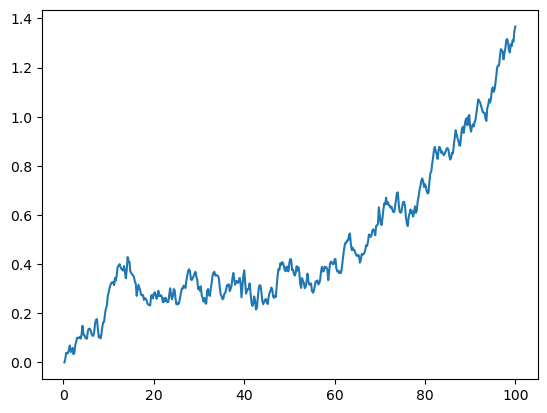

In [7]:
first_coord = t.xyz[0][6]
times = [STEP_SIZE*INTERVAL*(i+1) for i in range(STEPS//INTERVAL)]

caffeine_coords = t.xyz[:,6,:]

dists = optimised_dist(first_coord, caffeine_coords, 5)

fig, ax = plt.subplots()
ax.plot(times, dists)

In [ ]:
fig, ax1 = plt.subplots()
fig, ax2 = plt.subplots()
av_dists = []

#for i, colour in zip(range(300), ['blue', 'green', 'red', 'magenta', 'black']): 
for i in range(300): 
    integrator = LangevinMiddleIntegrator(300*kelvin, 1/picosecond, stepSize*picosecond)

    simulation = Simulation(prmtop.topology, system, integrator)
    simulation.context.setPositions(inpcrd.positions)
    print('Minimizing...')
    simulation.minimizeEnergy()

    print('Simulating...')
    simulation.reporters.append(DCDReporter(f'temp_output{i+1}.dcd', INTERVAL))
    #simulation.reporters.append(StateDataReporter(stdout, 10000, step=True,
    #        potentialEnergy=True, temperature=True))
    simulation.step(STEPS)
    print(f'Simulation {i+1} done.')

    t = md.load(f'temp_output{i+1}.dcd', top='caffeine-large.pdb')

    first_coord = t.xyz[0][6]
    times = [STEP_SIZE*INTERVAL*(i+1) for i in range(STEPS//INTERVAL)]

    caffeine_coords = t.xyz[:,6,:]

    dists = optimised_dist(first_coord, caffeine_coords, SIZE)
    av_dists.append(dists)

    #ax1.plot(times, dists, color=colour)
    ax1.plot(times, dists)
    ax1.set_title('Displacement vs Time (300 Simulations)')
    ax1.set_xlabel('Time Elapsed (picoseconds)')
    ax1.set_ylabel('Displacement (nanometers)')

av_dists = np.mean(av_dists, axis=0)

ax2.plot(times, av_dists)
ax2.set_title('Av. Displacement vs Time')
ax2.set_xlabel('Time Elapsed (picoseconds)')
ax2.set_ylabel('Displacement (nanometers)')

In [4]:
multi_sim_trajectories = []
for sim in [name for name in os.listdir('Other Sims') if name != ".DS_Store"]:
    print(f'Loading {sim}...')
    t = md.load(f'Other Sims/{sim}', top='caffeine-large.pdb')
    multi_sim_trajectories.append(t)

Loading temp_output126.dcd...
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
Loading temp_output132.dcd...
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
Loading temp_output23.dcd...
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
Loading temp_output37.dcd...
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
Loading temp_output36.dcd...
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
Loading temp_output22.dcd...
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
Loading temp_output133.dcd...
dcdplugin) detected standard 32-bit DC

In [ ]:
multi_sim_coords = []
#shapes = []
#i = 0
for t in multi_sim_trajectories:
#    i+=1
    multi_sim_coords.append(t.xyz)
    #shapes.append(np.shape(t.xyz))

#multi_sim_coords = np.array(multi_sim_coords, dtype='object')

print(type(multi_sim_coords))
print(multi_sim_coords)
#print([shape for shape in shapes if shape != (500, 9451, 3)])
#print(len(multi_sim_coords))
#print(np.shape(multi_sim_coords))

<class 'list'>
[array([[[2.4903982, 2.7282133, 2.4088275],
        [2.4011476, 2.279497 , 2.3931665],
        [2.6223104, 2.3410614, 2.3896554],
        ...,
        [1.3744916, 1.4757441, 1.3713931],
        [1.4475917, 1.4174902, 1.3507731],
        [1.4093021, 1.5352894, 1.4377623]],

       [[2.4774537, 2.7225103, 2.4311483],
        [2.4045818, 2.2715433, 2.377537 ],
        [2.626777 , 2.3445597, 2.3837903],
        ...,
        [1.3800303, 1.4739141, 1.3702055],
        [1.4463286, 1.4100227, 1.3440381],
        [1.4183154, 1.5186055, 1.4456989]],

       [[2.4756572, 2.7151277, 2.435153 ],
        [2.417631 , 2.266721 , 2.3660638],
        [2.6398015, 2.3437984, 2.388224 ],
        ...,
        [1.376238 , 1.4614098, 1.3657503],
        [1.437697 , 1.4015323, 1.3233265],
        [1.4112179, 1.4730116, 1.4540912]],

       ...,

       [[2.4945123, 1.8851645, 2.4822216],
        [2.5905578, 2.0741513, 2.8974972],
        [2.6843083, 1.8715633, 2.849302 ],
        ...,
        [1

: 

[[array([[2.4903982, 2.7282133, 2.4088275],
       [2.4011476, 2.279497 , 2.3931665],
       [2.6223104, 2.3410614, 2.3896554],
       ...,
       [1.3744916, 1.4757441, 1.3713931],
       [1.4475917, 1.4174902, 1.3507731],
       [1.4093021, 1.5352894, 1.4377623]], shape=(9451, 3), dtype=float32), array([[2.4774537, 2.7225103, 2.4311483],
       [2.4045818, 2.2715433, 2.377537 ],
       [2.626777 , 2.3445597, 2.3837903],
       ...,
       [1.3800303, 1.4739141, 1.3702055],
       [1.4463286, 1.4100227, 1.3440381],
       [1.4183154, 1.5186055, 1.4456989]], shape=(9451, 3), dtype=float32), array([[2.4756572, 2.7151277, 2.435153 ],
       [2.417631 , 2.266721 , 2.3660638],
       [2.6398015, 2.3437984, 2.388224 ],
       ...,
       [1.376238 , 1.4614098, 1.3657503],
       [1.437697 , 1.4015323, 1.3233265],
       [1.4112179, 1.4730116, 1.4540912]], shape=(9451, 3), dtype=float32), array([[2.4765694, 2.7214315, 2.4010446],
       [2.4372642, 2.2641637, 2.3869848],
       [2.6419675, 2

In [ ]:
multi_sim_coords = np.empty([0, 500, 9451, 3])
i = 0
for t in multi_sim_trajectories:
    i+=1
    multi_sim_coords = np.append(multi_sim_coords, t.xyz)
    print(i,end='')

#print(type(multi_sim_coords))
#print(multi_sim_coords)
#print(len(multi_sim_coords))
#print(np.shape(multi_sim_coords))

1234567891011121314151617181920212223

In [77]:
print(multi_sim_coords)

#dists = even_more_optimised_dist(multi_sim_coords[:,0,6,:], multi_sim_coords[:,:,6,:], SIZE)

[]


1 500
2 500
3 500
4 500
5 500
6 500
7 500
8 500
9 500
10 500
11 500
12 500
13 500
14 500
15 500
16 500
17 500
18 500
19 500
20 500
21 500
22 500
23 500
24 500
25 500
26 500
27 500
28 500
29 500
30 500
31 500
32 500
33 500
34 500
35 500
36 500
37 500
38 500
39 500
40 500
41 500
42 500
43 500
44 500
45 500
46 500
47 500
48 500
49 500
50 500
51 500
52 500
53 500
54 500
55 500
56 500
57 500
58 500
59 500
60 500
61 500
62 500
63 500
64 500
65 500
66 500
67 500
68 500
69 500
70 500
71 500
72 500
73 500
74 500
75 500
76 500
77 500
78 500
79 500
80 500
81 500
82 500
83 500
84 500
85 500
86 500
87 500
88 500
89 500
90 500
91 500
92 500
93 500
94 500
95 500
96 500
97 500
98 500
99 500
100 500
101 500
102 500
103 500
104 500
105 500
106 500
107 500
108 500
109 500
110 500
111 500
112 500
113 500
114 257


ValueError: x and y must have same first dimension, but have shapes (500,) and (257,)

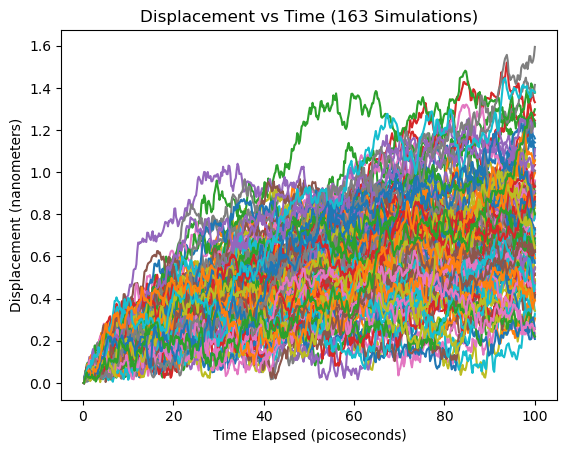

In [ ]:
fig, ax = plt.subplots()
av_dists = []
for coords in multi_sim_coords:
    first_coord = coords[0][6]
    times = [STEP_SIZE*INTERVAL*(i+1) for i in range(STEPS//INTERVAL)]

    caffeine_coords = coords[:,6,:]

    dists = optimised_dist(first_coord, caffeine_coords, SIZE)
    print(i, len(dists))
    av_dists.append(dists)

    #ax.plot(times, dists, color=colour)
    ax.plot(times, dists)
    ax.set_title('Displacement vs Time (163 Simulations)')
    ax.set_xlabel('Time Elapsed (picoseconds)')
    ax.set_ylabel('Displacement (nanometers)')
    i+=1
    

dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)
dcdplugin) detected standard 32-bit DCD file of native endianness
dcdplugin) CHARMM format DCD file (also NAMD 2.1 and later)


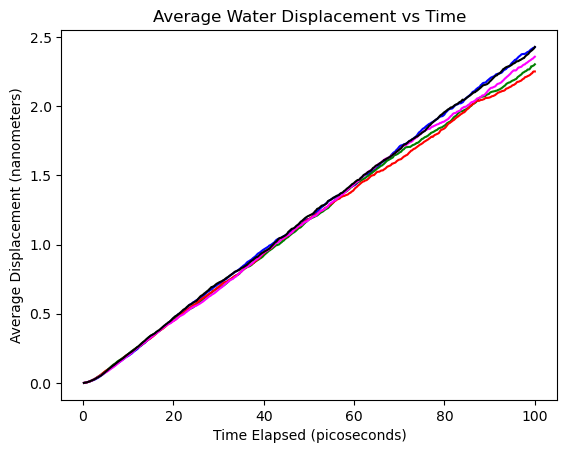

In [ ]:
fig, ax = plt.subplots()

for i, colour in zip(range(5), ['blue', 'green', 'red', 'magenta', 'black']): 
    t = md.load(f'temp_output{i+1}.dcd', top='caffeine-large.pdb')

    times = [STEP_SIZE*INTERVAL*(i+1) for i in range(STEPS//INTERVAL)]
    oxygen_indexes = [atom.index for atom in t[0].topology.atoms if atom.element.symbol == 'O']
    oxygen_coords = t.xyz[:,oxygen_indexes,:]
    dists = even_more_optimised_dist(oxygen_coords[0], oxygen_coords, SIZE)
    av_dists = np.mean(dists,axis=1)**2

    ax.plot(times, av_dists, color=colour)
    ax.set_title('Average Water Displacement vs Time')
    ax.set_xlabel('Time Elapsed (picoseconds)')
    ax.set_ylabel('Average Square Displacement (nanometers)')

In [ ]:
x = np.array([[1,2,3,4,5], [3,4,5,6,7]])
print(np.mean(x))

[3. 5.]


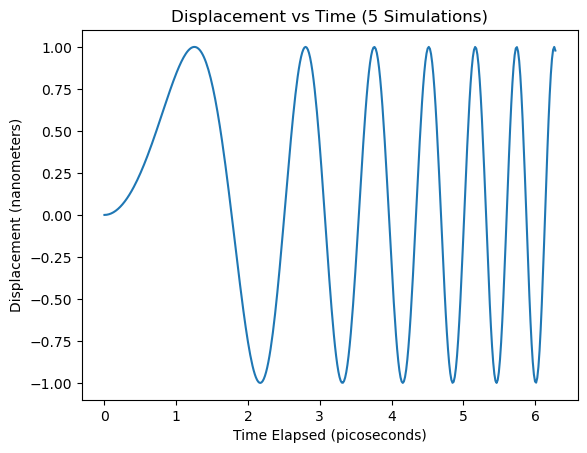

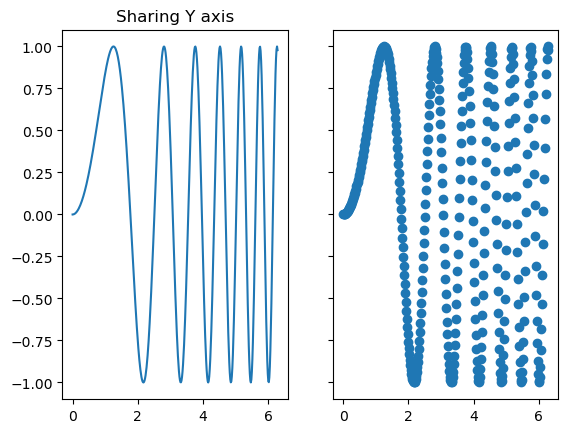

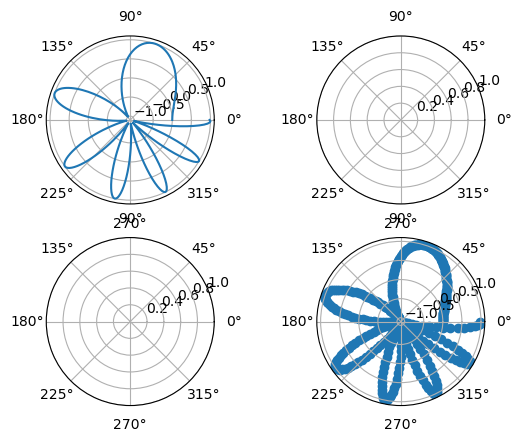

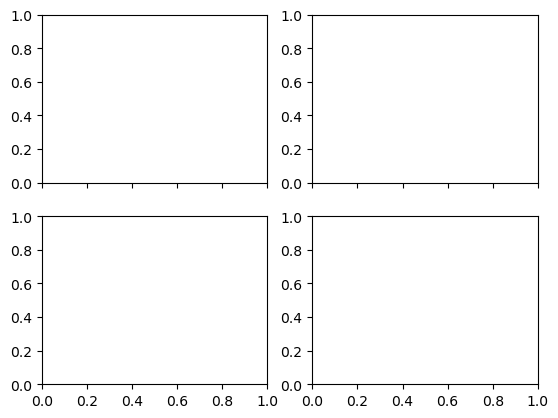

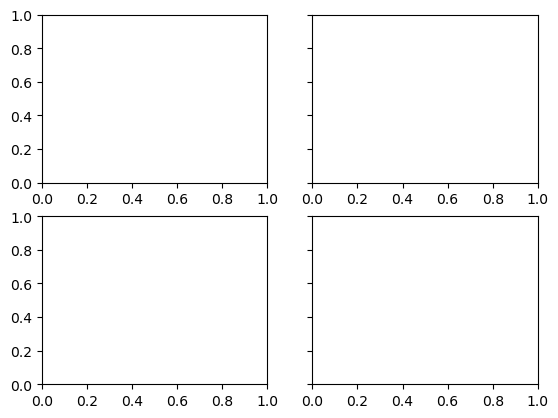

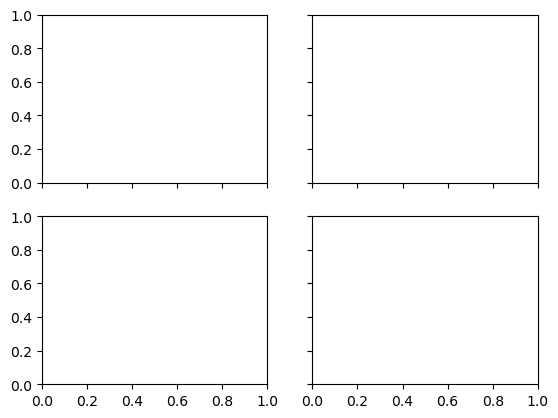

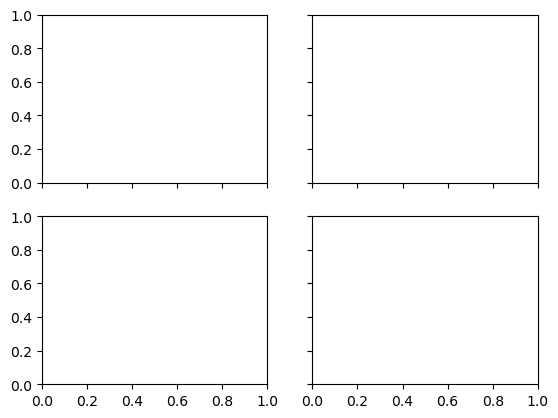

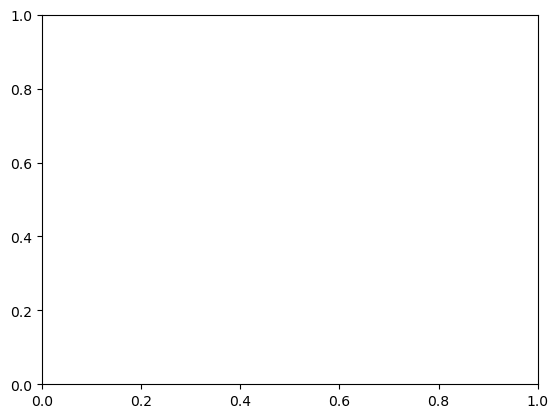

In [89]:
# First create some toy data:
x = np.linspace(0, 2*np.pi, 400)
y = np.sin(x**2)

# Create just a figure and only one subplot
fig, ax = plt.subplots()
ax.plot(x, y)
ax.set_title('Displacement vs Time (5 Simulations)')
ax.set_xlabel('Time Elapsed (picoseconds)')
ax.set_ylabel('Displacement (nanometers)')

# Create two subplots and unpack the output array immediately
f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
ax1.plot(x, y)
ax1.set_title('Sharing Y axis')
ax2.scatter(x, y)

# Create four polar Axes and access them through the returned array
fig, axs = plt.subplots(2, 2, subplot_kw=dict(projection="polar"))
axs[0, 0].plot(x, y)
axs[1, 1].scatter(x, y)

# Share a X axis with each column of subplots
plt.subplots(2, 2, sharex='col')

# Share a Y axis with each row of subplots
plt.subplots(2, 2, sharey='row')

# Share both X and Y axes with all subplots
plt.subplots(2, 2, sharex='all', sharey='all')

# Note that this is the same as
plt.subplots(2, 2, sharex=True, sharey=True)

# Create figure number 10 with a single subplot
# and clears it if it already exists.
fig, ax = plt.subplots(num=10, clear=True)